# Plotting

<div>
    <img style='width: 220px;height: 100px;float: left;' src="./Supplementary_data/EODC-Logo-Final.png" height='100px' width='220px'/>
    <img style='width: 200px;height: 100px;float: left;' src="./Supplementary_data/BMNT_DE_Logo_dreizeilig_srgb.svg" height='100px' width='200px'/> 
    <img style='width: 200px;height: 100px;float: left;' src="./Supplementary_data/bmlv.svg" height='100px' width='200px'/>
    <img style='width: 200px;height: 100px;float: left;' src="./Supplementary_data/LOGO_TUW_GEO.png" height='100px' width='200px'/>
    <img style='width: 100px;height: 100px;float: left;' src="./Supplementary_data/Boku-wien.svg" height='100px' width='100px'/>
    <img style='width: 150px;height: 100px;float: right;' src="./Supplementary_data/ADC_Logo_final_transparent.png" height='100px' width='150px'/>
</div>

This notebook shows how to create different kinds of plots using the ACube data. The libraries for creating plots can be a great tool for analysis of certain values and for decision making.

## Imports and setup

In [1]:
import datacube
import xarray
%matplotlib inline
acube = datacube.Datacube(app='sample_3')

## Image plot

In this example we load the Monhly FAPAR calculated from Sentinel-2 imagery. This product contains a single measurement called `band_1` which we shall display.

To plot a single image the `xarray.Dataset` needs to be converted to an `xarray.DataArray`. This can be done either by:
* selecting the measurement
* using the `to_array` function

For now we will select the `band_1` measurement for the `MFAPAR_Sentinel_2` product.

To create a plot we use the `plot` function which, in this case, takes several arguments:
* `x` and `y` - coordinate axis
* `col` - the column for the values
* `size` - size of the plot
* `cmap` - the color map for the plot, A full list of colormaps can be found [here](https://matplotlib.org/3.2.0/tutorials/colors/colormaps.html "Choosing Colormaps in Matplotlib")
* `vmax` and `vmin` - value limits for the plot

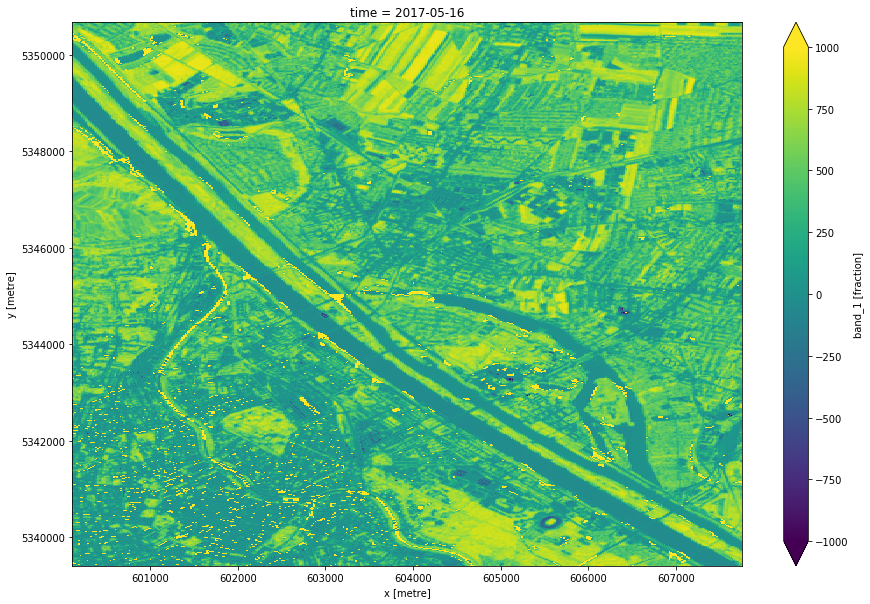

In [2]:
query_product = 'MFAPAR_Sentinel_2'
query_spatiotemporal = {
    'lon': (16.35, 16.45),
    'lat': (48.2, 48.3),
    'time': ('2017-05-01', '2017-05-31')
}
data = acube.load(product=query_product, output_crs='EPSG:32633', resolution=(-10, 10), **query_spatiotemporal)
data_plot = data.band_1
data_plot.plot(size=10, cmap='viridis', vmax=1000, vmin=-1000)

## Multi-band (RGB) plot

In this example we load the B product and mesaurements `B02`, `B03`, `B04`. Since this data has been scaled, we will clear `fake_saturation` values over 2000. In this example we use the `to_array` function to convert the `xarray.Dataset` into `xarray.DataArray`.

Additionally we use the `col_wrap` to display 2 images per line in the plot. Since this plot has multiple dimensions we have to use the `plot.imshow()` function.

Inspecting the plot, we can see that there are a lot of fully black (nodata) images. This means that there are datasets on these dates near the queried area, but they do not contain any data.

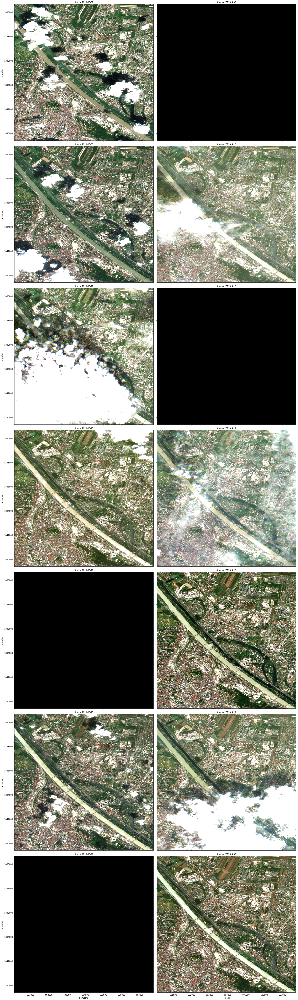

In [3]:
query_product = 'B_Sentinel_2'
query_spatiotemporal = {
    'lon': (16.35, 16.45),
    'lat': (48.2, 48.3),
    'time': ('2019-06-01', '2019-06-30')
}
data = acube.load(product=query_product, output_crs='EPSG:32633', measurements=['B04', 'B03', 'B02'], resolution=(-10, 10), **query_spatiotemporal)
data_plot = data.to_array(dim='color')
fake_saturation = 2000
data_plot = data_plot.transpose(*(data_plot.dims[1:]+data_plot.dims[:1]))
data_plot = data_plot.where((data_plot <= fake_saturation).all(dim='color'))
data_plot /= fake_saturation
data_plot.plot.imshow(
    x=data.crs.dimensions[1], 
    y=data.crs.dimensions[0],
    col='time',
    size=10,
    col_wrap=2,
)

It is posible to subset some values given their dates or indexes. The code below selects the two slices:
* 2019-06-20
* 2019-06-30

The rest is the same saturation and plotting as above.

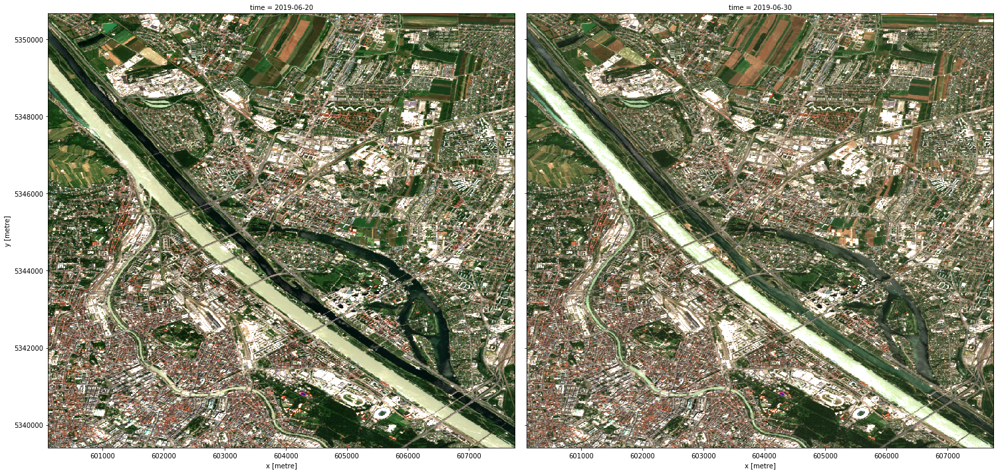

In [4]:
datasets = []
teporal_data = ['2019-06-20', '2019-06-30']
for time in teporal_data:
    datasets.append(data.sel(time=time))
new_data = xarray.concat([dataset for dataset in datasets], dim='time')
new_data_plot = new_data.to_array(dim='color')
fake_saturation = 2000
new_data_plot = new_data_plot.transpose(*(new_data_plot.dims[1:]+new_data_plot.dims[:1]))
new_data_plot = new_data_plot.where((new_data_plot <= fake_saturation).all(dim='color'))
new_data_plot /= fake_saturation
new_data_plot.plot.imshow(
    x=data.crs.dimensions[1], 
    y=data.crs.dimensions[0],
    col='time',
    size=10,
    col_wrap=2
)

## Histogram

This example shows how to plot a histogram. For this example we shall use Sentinel-1 SIG0 data. To invoke a histogram we simply call the `plot.hist()` function on the `xarray.DataArray`

In [5]:
query_product = 'MMENSIG0_Sentinel_1'
query_spatiotemporal = {
    'lon': (16.35, 16.45),
    'lat': (48.2, 48.3),
    'time': ('2019-06-01', '2019-06-30')
}
data = acube.load(product=query_product, 
               measurements=['VV', 'VH'], 
               output_crs='EPSG:32633', 
               resolution=(-10,10),
                **query_spatiotemporal)
data_plot_vh = data.VH
data_plot_vv = data.VV

(array([5.47090e+04, 2.37807e+05, 3.57362e+05, 1.63804e+05, 4.03030e+04,
        5.22400e+03, 8.29000e+02, 1.79000e+02, 3.90000e+01, 8.00000e+00]),
 array([-2511., -1994., -1477.,  -960.,  -443.,    74.,   591.,  1108.,
         1625.,  2142.,  2659.]),
 <a list of 10 Patch objects>)

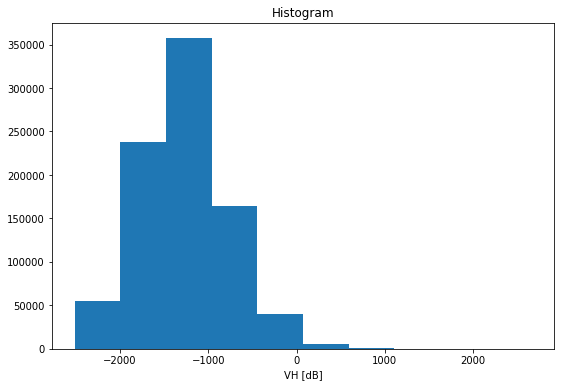

In [6]:
data_plot_vh.plot.hist(size=6)

(array([4.78160e+04, 1.20573e+05, 3.89960e+05, 2.31303e+05, 5.94130e+04,
        9.47400e+03, 1.39000e+03, 2.57000e+02, 5.90000e+01, 1.90000e+01]),
 array([-2152. , -1583.6, -1015.2,  -446.8,   121.6,   690. ,  1258.4,
         1826.8,  2395.2,  2963.6,  3532. ]),
 <a list of 10 Patch objects>)

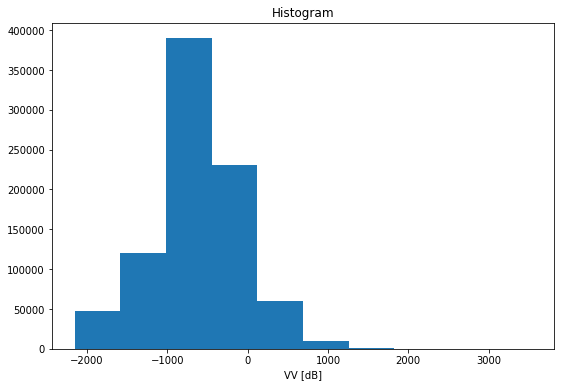

In [7]:
data_plot_vv.plot.hist(size=6)

## Pixel drill - Temporal line plot

In this example we will load the sufrace soil moisture product and plot how the soilmoisture changes over time. For this we use the `where` to subset only the data that have values, and `sel` that selects the nearest (or different `method` provided) pixel to the given point.

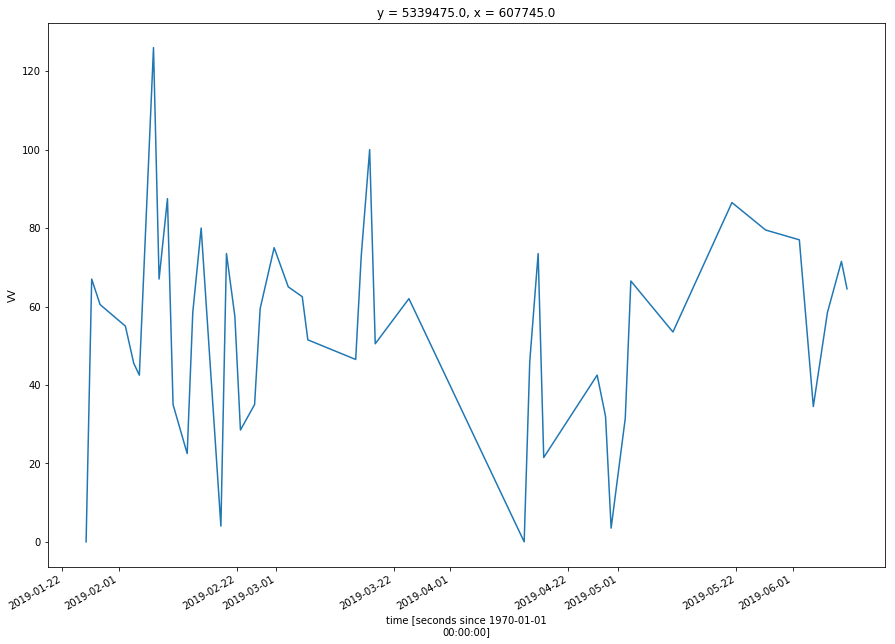

In [8]:
query_product = 'SSM_Sentinel_1'
query_spatiotemporal = {
    'lon': (16.4, 16.45),
    'lat': (48.2, 48.25),
    'time': ('2019-01-01', '2019-06-30')
}
data = acube.load(product=query_product,  
               output_crs='EPSG:32633', 
               resolution=(-10,10),
                **query_spatiotemporal)
data_plot = data.VV / 2
data_plot = data_plot.where(data.VV != data.VV.attrs['nodata']).dropna(dim='time')
selection = data_plot.sel(y=605000, x=5340000, method='nearest')
selection.plot(size=10)

## Interactive geographic plot

The library `bokeh` provides an option to create interactive plots and embed them in a notebook. The code below creates an interactive map preview over Austria. The idea is to use the axis for lat and lon queries.

In [9]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.tile_providers import CARTODBPOSITRON
output_notebook()
p = figure(x_range=(1035200, 1933200), y_range=(5750600, 6376100),
           x_axis_type="mercator", y_axis_type="mercator", tools='pan, wheel_zoom, reset', active_scroll='wheel_zoom')
p.add_tile(CARTODBPOSITRON)

show(p)

Loading BokehJS ...